This notebook was made in Kaggle

In [1]:
FROM_BLOCK_TIMESTAMP = "'2018-11-02 00:00:00'" # deploy
# FROM_BLOCK_TIMESTAMP = "'2019-08-25 23:59:59'" # test
TO_BLOCK_TIMESTAMP = "'2019-09-23 23:59:59'" 
# TO_BLOCK_TIMESTAMP = "'2018-12-30 00:00:00'" #test
MY_TIMEOUT = 300

# relevant Events signatures

events_signatures = {
    'TokenPurchase': 'TokenPurchase(address,uint256,uint256)', #event({buyer: indexed(address), eth_sold: indexed(uint256(wei)), tokens_bought: indexed(uint256)})
    'EthPurchase': 'EthPurchase(address,uint256,uint256',#,event({buyer: indexed(address), tokens_sold: indexed(uint256), eth_bought: indexed(uint256(wei))})
    'AddLiquidity': 'AddLiquidity(address,uint256,uint256)',#,event({provider: indexed(address), eth_amount: indexed(uint256(wei)), token_amount: indexed(uint256)})
    'RemoveLiquidity': 'RemoveLiquidity(address,uint256,uint256)',#,event({provider: indexed(address), eth_amount: indexed(uint256(wei)), token_amount: indexed(uint256)})
    'Transfer': 'Transfer(address,address,uint256)',#,event({_from: indexed(address), _to: indexed(address), _value: uint256})
    'Approval': 'Approval(address,address,uint256)'#,event({_owner: indexed(address), _spender: indexed(address), _value: uint256})
}
events_hashes = {
    'cd60aa75dea3072fbc07ae6d7d856b5dc5f4eee88854f5b4abf7b680ef8bc50f': 'TokenPurchase',
    '7f4091b46c33e918a0f3aa42307641d17bb67029427a5369e54b353984238705': 'EthPurchase',
    '06239653922ac7bea6aa2b19dc486b9361821d37712eb796adfd38d81de278ca': 'AddLiquidity',
    '0fbf06c058b90cb038a618f8c2acbf6145f8b3570fd1fa56abb8f0f3f05b36e8': 'RemoveLiquidity',
    'ddf252ad1be2c89b69c2b068fc378daa952ba7f163c4a11628f55a4df523b3ef': 'Transfer',
    '8c5be1e5ebec7d5bd14f71427d1e84f3dd0314c0f7b2291e5b200ac8c7c3b925': 'Approval'
}
contracts = {
    '0x09cabEC1eAd1c0Ba254B09efb3EE13841712bE14'.lower(): 'DAI'
}
contracts

{'0x09cabec1ead1c0ba254b09efb3ee13841712be14': 'DAI'}

> # Uniswap ETHDAI Analysis

In [2]:
from google.cloud import bigquery
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
pd.set_option('max_colwidth', 70)

In [3]:
#events = pd.read_pickle('ck-data/events_4605167-to-5374870.pickle.gz')
client = bigquery.Client()
query = """
SELECT 
  events.transaction_hash AS transactionHash,
  events.transaction_index,
  txns.from_address AS transaction_sender, 
  events.address,
  events.data,
  events.topics,
  events.block_timestamp,
  events.block_number AS blockNumber_dec
FROM
  `bigquery-public-data.ethereum_blockchain.logs` AS events
INNER JOIN
  `bigquery-public-data.ethereum_blockchain.transactions` AS txns
ON
  events.transaction_hash = txns.hash
WHERE TRUE
  AND events.block_timestamp >= {from_block_ts} 
  AND events.block_timestamp <= {to_block_ts}
  AND txns.block_timestamp >= {from_block_ts} --might seem redundant, but because of partitioning this reduces cost
  AND txns.block_timestamp <= {to_block_ts} --might seem redundant, but because of partitioning this reduces cost
  AND events.address IN ({contract_list})
""".format(
    from_block_ts=FROM_BLOCK_TIMESTAMP, 
    to_block_ts=TO_BLOCK_TIMESTAMP, 
    contract_list=(','.join(["'{}'".format(k) for k in list(contracts.keys())])))
print(query)
query_job = client.query(query)
iterator = query_job.result(timeout=MY_TIMEOUT)
rows = list(iterator)
events = pd.DataFrame(data=[list(x.values()) for x in rows], columns=list(rows[0].keys()))
events['contract'] = events['address'].apply(lambda x: contracts[x])
events['event'] = events['topics'].apply(lambda x: events_hashes[x[0][2:]])
events = events.sort_values(['blockNumber_dec','transaction_index']).reset_index(drop=True)
events.head(10)

Using Kaggle's public dataset BigQuery integration.

SELECT 
  events.transaction_hash AS transactionHash,
  events.transaction_index,
  txns.from_address AS transaction_sender, 
  events.address,
  events.data,
  events.topics,
  events.block_timestamp,
  events.block_number AS blockNumber_dec
FROM
  `bigquery-public-data.ethereum_blockchain.logs` AS events
INNER JOIN
  `bigquery-public-data.ethereum_blockchain.transactions` AS txns
ON
  events.transaction_hash = txns.hash
WHERE TRUE
  AND events.block_timestamp >= '2018-11-02 00:00:00' 
  AND events.block_timestamp <= '2019-09-23 23:59:59'
  AND txns.block_timestamp >= '2018-11-02 00:00:00' --might seem redundant, but because of partitioning this reduces cost
  AND txns.block_timestamp <= '2019-09-23 23:59:59' --might seem redundant, but because of partitioning this reduces cost
  AND events.address IN ('0x09cabec1ead1c0ba254b09efb3ee13841712be14')



,transactionHash,transaction_index,transaction_sender,address,data,topics,block_timestamp,blockNumber_dec,contract,event
0,0xbd773ccc33c831378f2aa2b7d4a9ae8a20ed9112ea9acb86ce96aa674c0cb5f9,150,0xf369af914dbed0ad7afdddebc631ee0fda1b4891,0x09cabec1ead1c0ba254b09efb3ee13841712be14,0x,[0x06239653922ac7bea6aa2b19dc486b9361821d37712eb796adfd38d81de278c...,2018-11-02 10:27:36+00:00,6629139,DAI,AddLiquidity
1,0xbd773ccc33c831378f2aa2b7d4a9ae8a20ed9112ea9acb86ce96aa674c0cb5f9,150,0xf369af914dbed0ad7afdddebc631ee0fda1b4891,0x09cabec1ead1c0ba254b09efb3ee13841712be14,0x000000000000000000000000000000000000000000000001a055690d9db80000,[0xddf252ad1be2c89b69c2b068fc378daa952ba7f163c4a11628f55a4df523b3e...,2018-11-02 10:27:36+00:00,6629139,DAI,Transfer
2,0xd53f01fc0cabbf4083da93a023ddb81de91320027077849ac982f7bc04b49279,97,0xf369af914dbed0ad7afdddebc631ee0fda1b4891,0x09cabec1ead1c0ba254b09efb3ee13841712be14,0x,[0x7f4091b46c33e918a0f3aa42307641d17bb67029427a5369e54b35398423870...,2018-11-02 10:33:56+00:00,6629171,DAI,EthPurchase
3,0x53172898dbe437c784f7e4ac757087b28d1b06aa6b72b81d4a6bb2bead50c93e,53,0xf369af914dbed0ad7afdddebc631ee0fda1b4891,0x09cabec1ead1c0ba254b09efb3ee13841712be14,0x,[0x7f4091b46c33e918a0f3aa42307641d17bb67029427a5369e54b35398423870...,2018-11-02 10:35:47+00:00,6629177,DAI,EthPurchase
4,0x6cef57fd37d7a2602c1236ff080c61c37e10980c7e3bd66de6f4e0ed52f16011,24,0x11e4857bb9993a50c685a79afad4e6f65d518dda,0x09cabec1ead1c0ba254b09efb3ee13841712be14,0x,[0xcd60aa75dea3072fbc07ae6d7d856b5dc5f4eee88854f5b4abf7b680ef8bc50...,2018-11-02 10:38:18+00:00,6629190,DAI,TokenPurchase
5,0x13d958222cbec3f6ae93e8f73af0f6ce800541db27a048258ac0645fc37e627e,281,0x11e4857bb9993a50c685a79afad4e6f65d518dda,0x09cabec1ead1c0ba254b09efb3ee13841712be14,0x,[0xcd60aa75dea3072fbc07ae6d7d856b5dc5f4eee88854f5b4abf7b680ef8bc50...,2018-11-02 10:39:55+00:00,6629198,DAI,TokenPurchase
6,0x51f662378a5e158bece87f19c5537fe69805e7163fe409f782000a66b0a44582,121,0x4defa30195094963cfac7285d8d6e6e523c7f90d,0x09cabec1ead1c0ba254b09efb3ee13841712be14,0x,[0xcd60aa75dea3072fbc07ae6d7d856b5dc5f4eee88854f5b4abf7b680ef8bc50...,2018-11-02 11:02:14+00:00,6629301,DAI,TokenPurchase
7,0x31f62df00bd7be033d6e4c959dfc7f596c2ec0902cda9d87c3b9c35a032b817d,51,0x4defa30195094963cfac7285d8d6e6e523c7f90d,0x09cabec1ead1c0ba254b09efb3ee13841712be14,0x,[0x06239653922ac7bea6aa2b19dc486b9361821d37712eb796adfd38d81de278c...,2018-11-02 11:04:09+00:00,6629306,DAI,AddLiquidity
8,0x31f62df00bd7be033d6e4c959dfc7f596c2ec0902cda9d87c3b9c35a032b817d,51,0x4defa30195094963cfac7285d8d6e6e523c7f90d,0x09cabec1ead1c0ba254b09efb3ee13841712be14,0x000000000000000000000000000000000000000000000000002250f2cdb2da75,[0xddf252ad1be2c89b69c2b068fc378daa952ba7f163c4a11628f55a4df523b3e...,2018-11-02 11:04:09+00:00,6629306,DAI,Transfer
9,0x865a3da7b390858ca91fc5b89885ec8e61115b8817442161b6d4b1afefefcdab,7,0x11e4857bb9993a50c685a79afad4e6f65d518dda,0x09cabec1ead1c0ba254b09efb3ee13841712be14,0x,[0xcd60aa75dea3072fbc07ae6d7d856b5dc5f4eee88854f5b4abf7b680ef8bc50...,2018-11-02 11:17:38+00:00,6629362,DAI,TokenPurchase


In [4]:
print('Block range: ' + str(events.blockNumber_dec.min()) + ' to ' + str(events.blockNumber_dec.max()))

Block range: 6629139 to 8608513


In [5]:
events.groupby(['contract','event']).transactionHash.count()

contract  event          
DAI       AddLiquidity        2694
          Approval             152
          EthPurchase        45840
          RemoveLiquidity     1787
          TokenPurchase      46266
          Transfer            4747
Name: transactionHash, dtype: int64

^ As expected, most events refer to trades (EthPurchase and TokenPurchase)

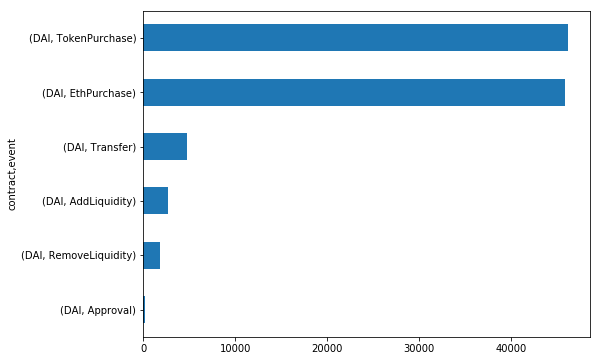

In [6]:
event_counts = events.groupby(['contract','event']).transactionHash.count()
event_counts.sort_values().plot(kind='barh', figsize=(8, 6))

In [7]:
event_counts_df = event_counts.reset_index()
event_counts_df.columns = ['contract', 'event', 'count']
event_counts_df

,contract,event,count
0,DAI,AddLiquidity,2694
1,DAI,Approval,152
2,DAI,EthPurchase,45840
3,DAI,RemoveLiquidity,1787
4,DAI,TokenPurchase,46266
5,DAI,Transfer,4747


In [8]:
events['contract_event'] = events['contract'] + events['event']
events['block_group'] = events['blockNumber_dec'].apply(lambda x: int(x/10000))

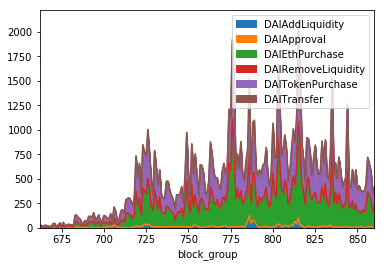

In [9]:
areaplot = events.groupby(['block_group','contract_event']).transactionHash.count().reset_index().pivot(index='block_group', columns='contract_event', values='transactionHash')#.plot.area()
areaplot.plot.area()
plt.legend(loc=1)

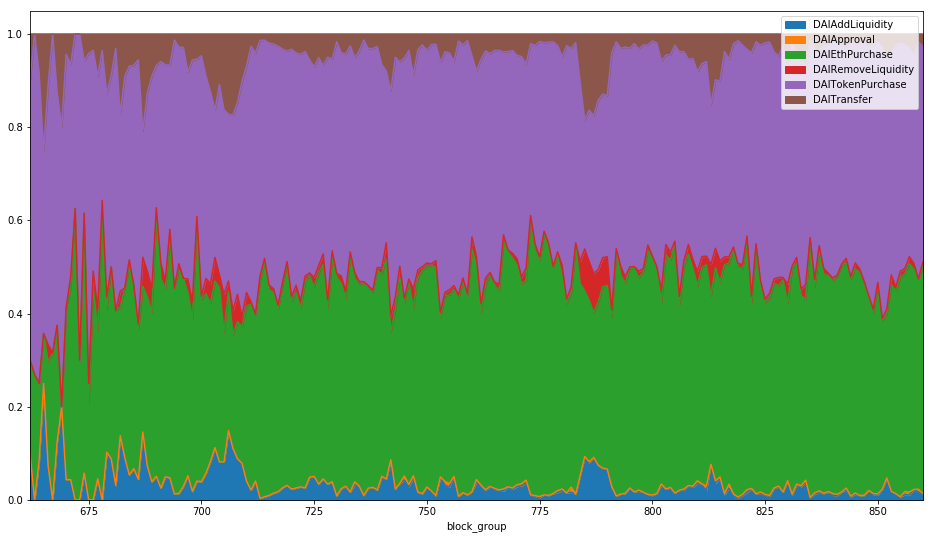

In [10]:
areaplot.divide(areaplot.sum(axis=1), axis=0).plot.area(figsize=(16, 9))
plt.legend(loc=1)

Remove Transfers and Approvals, as we won't need them going further

In [11]:
# events = events[~events.event.isin(['Transfer','Approval'])]
# events = events.drop('data', axis='columns')

In [12]:
events['agent'] = '0x' + events['topics'].apply(lambda x: x[1][26:66])

In [13]:
def getEthDeltaFromTopics(topics):
    event_hash = topics[0][2:]
    if events_hashes[event_hash] == 'TokenPurchase':
        return int(topics[2],16)
    if events_hashes[event_hash] == 'EthPurchase':
        return -int(topics[3],16)
    if events_hashes[event_hash] == 'AddLiquidity':
        return int(topics[2],16)
    if events_hashes[event_hash] == 'RemoveLiquidity':
        return -int(topics[2],16)
    return 0
    
def getTokenDeltaFromTopics(topics):
    event_hash = topics[0][2:]
    if events_hashes[event_hash] == 'TokenPurchase':
        return -int(topics[3],16)
    if events_hashes[event_hash] == 'EthPurchase':
        return int(topics[2],16)
    if events_hashes[event_hash] == 'AddLiquidity':
        return int(topics[3],16)
    if events_hashes[event_hash] == 'RemoveLiquidity':
        return -int(topics[3],16)
    return 0
    
def getUNIDeltaFromTopics(topics):
    event_hash = topics[0][2:]
    if events_hashes[event_hash] == 'Transfer':
        if topics[1] == '0x0000000000000000000000000000000000000000000000000000000000000000':
            return 1
        if topics[2] == '0x0000000000000000000000000000000000000000000000000000000000000000':
            return -1
    return 0
    
def getTradingVolumeFromTopics(topics):
    event_hash = topics[0][2:]
    if events_hashes[event_hash] == 'TokenPurchase':
        return int(topics[2],16)
    if events_hashes[event_hash] == 'EthPurchase':
        return int(topics[3],16)
    return 0
    
events['eth_delta'] = events['topics'].apply(getEthDeltaFromTopics)
events['token_delta'] = events['topics'].apply(getTokenDeltaFromTopics)

events['uni_delta'] = events['data'].apply(lambda x: 0 if x == '0x' else int(x,16))
events['uni_delta'] = events['uni_delta'] * events['topics'].apply(getUNIDeltaFromTopics)

events['eth_balance'] = events['eth_delta'].cumsum()
events['token_balance'] = events['token_delta'].cumsum()
events['UNI_supply'] = events['uni_delta'].cumsum()
events['invariant'] = events['eth_balance']*events['token_balance']
events.to_pickle('uniswap_events.pickle')
events.head()

,transactionHash,transaction_index,transaction_sender,address,data,topics,block_timestamp,blockNumber_dec,contract,event,contract_event,block_group,agent,eth_delta,token_delta,uni_delta,eth_balance,token_balance,UNI_supply,invariant
0,0xbd773ccc33c831378f2aa2b7d4a9ae8a20ed9112ea9acb86ce96aa674c0cb5f9,150,0xf369af914dbed0ad7afdddebc631ee0fda1b4891,0x09cabec1ead1c0ba254b09efb3ee13841712be14,0x,[0x06239653922ac7bea6aa2b19dc486b9361821d37712eb796adfd38d81de278c...,2018-11-02 10:27:36+00:00,6629139,DAI,AddLiquidity,DAIAddLiquidity,662,0xf369af914dbed0ad7afdddebc631ee0fda1b4891,30000000000000000000,5900000000000000000000,0,30000000000000000000,5900000000000000000000,0,177000000000000000000000000000000000000000
1,0xbd773ccc33c831378f2aa2b7d4a9ae8a20ed9112ea9acb86ce96aa674c0cb5f9,150,0xf369af914dbed0ad7afdddebc631ee0fda1b4891,0x09cabec1ead1c0ba254b09efb3ee13841712be14,0x000000000000000000000000000000000000000000000001a055690d9db80000,[0xddf252ad1be2c89b69c2b068fc378daa952ba7f163c4a11628f55a4df523b3e...,2018-11-02 10:27:36+00:00,6629139,DAI,Transfer,DAITransfer,662,0x0000000000000000000000000000000000000000,0,0,30000000000000000000,30000000000000000000,5900000000000000000000,30000000000000000000,177000000000000000000000000000000000000000
2,0xd53f01fc0cabbf4083da93a023ddb81de91320027077849ac982f7bc04b49279,97,0xf369af914dbed0ad7afdddebc631ee0fda1b4891,0x09cabec1ead1c0ba254b09efb3ee13841712be14,0x,[0x7f4091b46c33e918a0f3aa42307641d17bb67029427a5369e54b35398423870...,2018-11-02 10:33:56+00:00,6629171,DAI,EthPurchase,DAIEthPurchase,662,0xf369af914dbed0ad7afdddebc631ee0fda1b4891,-25326059253325791,5000000000000000000,0,29974673940746674209,5905000000000000000000,30000000000000000000,177000449620109111204145000000000000000000
3,0x53172898dbe437c784f7e4ac757087b28d1b06aa6b72b81d4a6bb2bead50c93e,53,0xf369af914dbed0ad7afdddebc631ee0fda1b4891,0x09cabec1ead1c0ba254b09efb3ee13841712be14,0x,[0x7f4091b46c33e918a0f3aa42307641d17bb67029427a5369e54b35398423870...,2018-11-02 10:35:47+00:00,6629177,DAI,EthPurchase,DAIEthPurchase,662,0xf369af914dbed0ad7afdddebc631ee0fda1b4891,-10118429075406013,2000000000000000000,0,29964555511671268196,5907000000000000000000,30000000000000000000,177000629407442181233772000000000000000000
4,0x6cef57fd37d7a2602c1236ff080c61c37e10980c7e3bd66de6f4e0ed52f16011,24,0x11e4857bb9993a50c685a79afad4e6f65d518dda,0x09cabec1ead1c0ba254b09efb3ee13841712be14,0x,[0xcd60aa75dea3072fbc07ae6d7d856b5dc5f4eee88854f5b4abf7b680ef8bc50...,2018-11-02 10:38:18+00:00,6629190,DAI,TokenPurchase,DAITokenPurchase,662,0x11e4857bb9993a50c685a79afad4e6f65d518dda,10000000000000000,-1964761376358359468,0,29974555511671268196,5905035238623641640532,30000000000000000000,177000806558499339943044863018842396120272


In [14]:
trades = events[events.event.isin(['TokenPurchase','EthPurchase'])].copy()
trades['trading_volume'] = abs(trades['eth_delta'])

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f5d71d225f8>]],
      dtype=object)

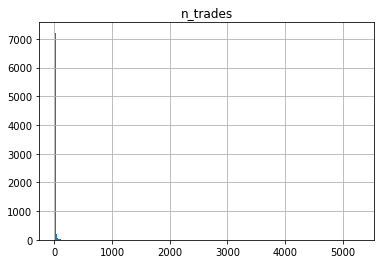

In [15]:
trades.groupby(['agent']).size().to_frame().rename(columns={0:'n_trades'}).hist(bins=300)

In [16]:
trades = trades.join(trades.groupby(['agent']).size().to_frame().rename(columns={0:'n_trades'}), on='agent')

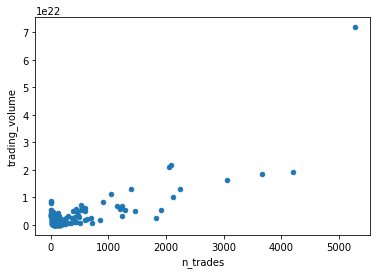

In [17]:
volume_frequency = trades.groupby(['n_trades']).trading_volume.sum()#.sort_values(ascending=False)
volume_frequency = volume_frequency.reset_index()
volume_frequency['trading_volume'] = volume_frequency['trading_volume'].astype(float)
volume_frequency.plot.scatter(x='n_trades', y='trading_volume')

In [18]:
topVolTraders = trades.groupby(['agent']).trading_volume.sum().sort_values(ascending=False)
topVolTraders = set(topVolTraders.head(20).index.values)

In [19]:
trades['agent_class_vol'] = trades['agent'].apply(lambda x: '1- Top Volume Trader' \
                                                if x in topVolTraders \
                                                else '2- Other')
trades['agent_class_freq'] = trades['n_trades'].apply(lambda x: '1- 200+' \
                                                if x>=200 \
                                                else '2- 10-199' if x>=10 \
                                                else '3- <10')

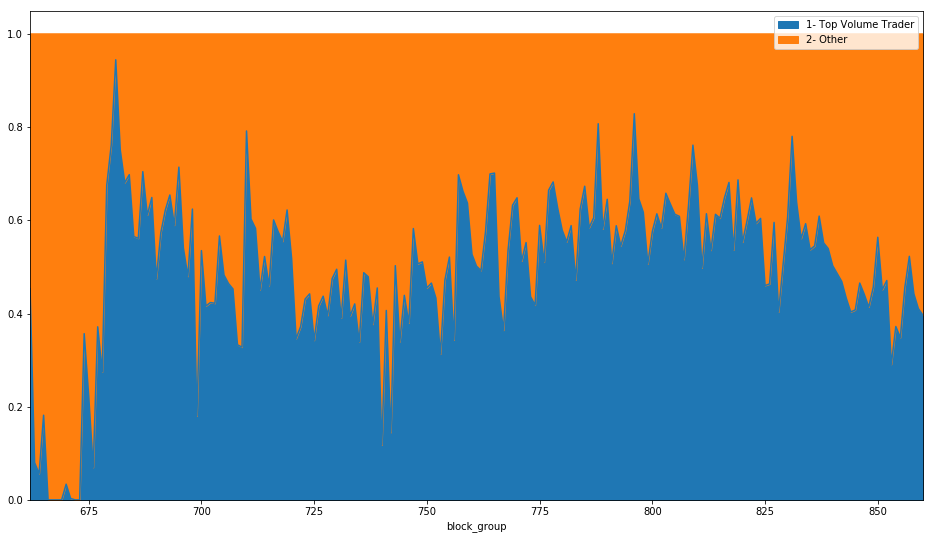

In [20]:
areaplot = trades.groupby(['block_group','agent_class_vol']).trading_volume.sum().reset_index().pivot(index='block_group', columns='agent_class_vol', values='trading_volume')
areaplot.divide(areaplot.sum(axis=1), axis=0).plot.area(figsize=(16, 9))
plt.legend(loc=1)

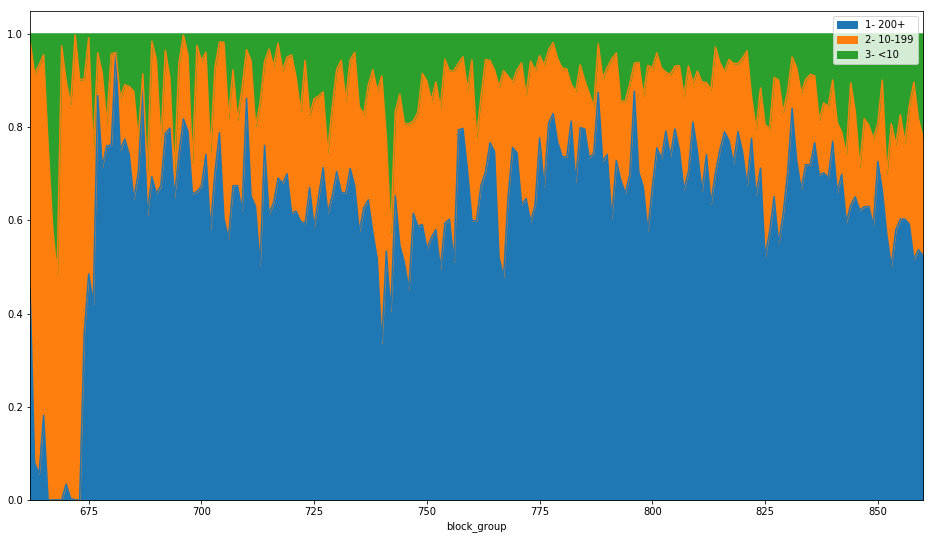

In [21]:
areaplot = trades.groupby(['block_group','agent_class_freq']).trading_volume.sum().reset_index().pivot(index='block_group', columns='agent_class_freq', values='trading_volume')
areaplot.divide(areaplot.sum(axis=1), axis=0).plot.area(figsize=(16, 9))
plt.legend(loc=1)

In [22]:
trades['isRound'] = (((trades['eth_delta']%1e15)==0) | ((trades['token_delta']%1e15)==0))
trades['isRound'] = trades['isRound'].apply(lambda x: 'Round Trade' if x else 'Not Round')

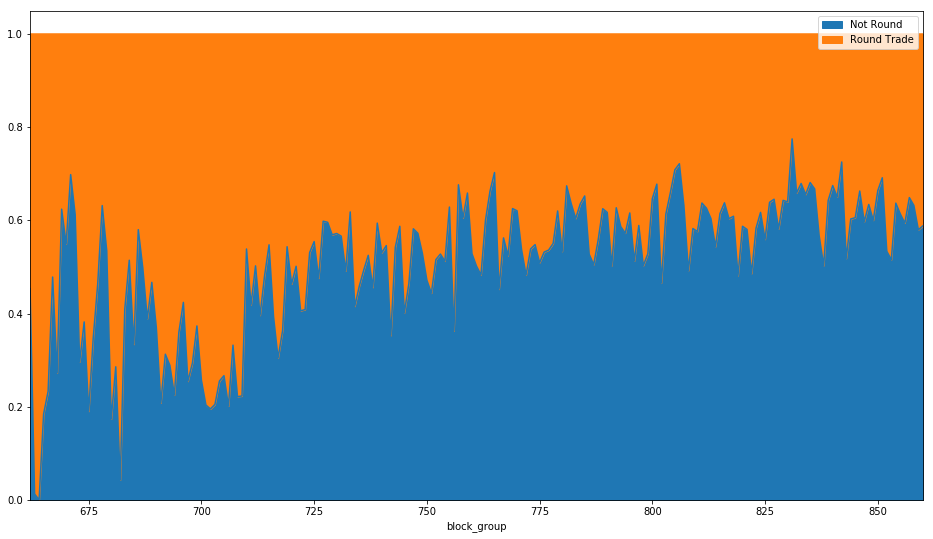

In [23]:
areaplot = trades.groupby(['block_group','isRound']).trading_volume.sum().reset_index().pivot(index='block_group', columns='isRound', values='trading_volume')
areaplot.divide(areaplot.sum(axis=1), axis=0).plot.area(figsize=(16, 9))
plt.legend(loc=1)

In [24]:
trades['isDirect'] = trades['transaction_sender']==trades['agent']
trades['isDirect'] = trades['isDirect'].apply(lambda x: '2- Traded directly' if x else '1- Traded via proxy')

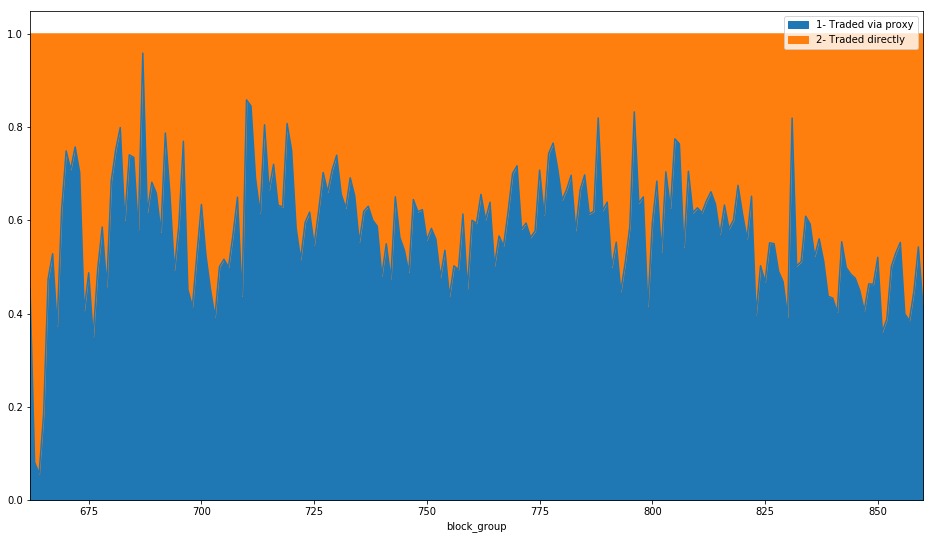

In [25]:
areaplot = trades.groupby(['block_group','isDirect']).trading_volume.sum().reset_index().pivot(index='block_group', columns='isDirect', values='trading_volume')
areaplot.divide(areaplot.sum(axis=1), axis=0).plot.area(figsize=(16, 9))
plt.legend(loc=1)

In [26]:
real_history = events.iloc[1:][['block_timestamp','token_balance','eth_balance','UNI_supply']].reset_index(drop=True)
real_history.columns = ['timestamp','real_DAI_balance', 'real_ETH_balance', 'real_UNI_supply']
freq = 'D'
plot_data = real_history.copy()
plot_data.columns = ['timestamp','DAI_balance','ETH_balance','UNI_supply']
plot_data[['DAI_balance','ETH_balance','UNI_supply']] = plot_data[['DAI_balance','ETH_balance','UNI_supply']]*1E-18
plot_data['ts_minute'] = plot_data['timestamp'].apply(lambda x: x.floor(freq))
plot_data = plot_data.drop_duplicates('ts_minute', keep='last')
plot_data.index = plot_data.ts_minute#,format='%Y-%m')
plot_data = plot_data.resample(freq).pad()
plot_data['ts_minute'] = plot_data.index
# plot_data['ts_minute'] = plot_data['ts_minute'].apply(lambda x: x.date())
plot_data = plot_data.drop('timestamp', axis='columns')
plot_data = plot_data.reset_index(drop=True)
plot_data['ETH_price_DAI'] = plot_data['DAI_balance'] / plot_data['ETH_balance']
plot_data['UNI_price_DAI'] = 2 * plot_data['DAI_balance'] / plot_data['UNI_supply']
plot_data['50_50_hodler_value'] = 0.5 * plot_data['ETH_price_DAI'][0] + 0.5 * plot_data['ETH_price_DAI']
plot_data['50_50_hodler_return'] = plot_data['50_50_hodler_value']/plot_data['50_50_hodler_value'][0] - 1
plot_data['UNI_hodler_return'] = plot_data['UNI_price_DAI']/plot_data['UNI_price_DAI'][0] - 1
plot_data['ETH_hodler_return'] = plot_data['ETH_price_DAI']/plot_data['ETH_price_DAI'][0] - 1
plot_data

,DAI_balance,ETH_balance,UNI_supply,ts_minute,ETH_price_DAI,UNI_price_DAI,50_50_hodler_value,50_50_hodler_return,UNI_hodler_return,ETH_hodler_return
0,5810.15,30.4969,30.0097,2018-11-02 00:00:00+00:00,190.516,387.219,190.516,0,0,0
1,5988.86,29.6193,30.0097,2018-11-03 00:00:00+00:00,202.195,399.129,196.356,0.0306502,0.0307579,0.0613005
2,6010.55,29.5135,30.0097,2018-11-04 00:00:00+00:00,203.654,400.574,197.085,0.0344792,0.0344901,0.0689583
3,6144.36,28.9117,30.0298,2018-11-05 00:00:00+00:00,212.521,409.217,201.519,0.0577507,0.0568101,0.115501
4,11322.7,53.8018,55.6061,2018-11-06 00:00:00+00:00,210.451,407.245,200.484,0.0523192,0.0517188,0.104638
...,...,...,...,...,...,...,...,...,...,...
321,1.33713e+06,6051.31,5354.83,2019-09-19 00:00:00+00:00,220.965,499.409,205.741,0.0799114,0.289734,0.159823
322,1.31479e+06,6063.89,5314.48,2019-09-20 00:00:00+00:00,216.823,494.795,203.669,0.0690403,0.277818,0.138081
323,1.30814e+06,6095.48,5314.24,2019-09-21 00:00:00+00:00,214.608,492.315,202.562,0.0632288,0.271413,0.126458
324,1.29778e+06,6166.66,5322.89,2019-09-22 00:00:00+00:00,210.451,487.622,200.484,0.0523184,0.259294,0.104637


In [27]:
# %%capture --no-display cell_capture
#avoid warnings in cell output

import matplotlib.pyplot as plt
import numpy as np
from IPython.display import HTML
from matplotlib import animation, rc
rc('animation', html='jshtml', embed_limit=50)
from matplotlib import cm
import matplotlib.ticker as ticker



fig, axs = plt.subplots(ncols=4, nrows=3,
                       figsize=(15,9),
                       gridspec_kw = {'hspace':0.4})

#grid setup
gs = axs[0, 0].get_gridspec()
# remove the underlying axes
for ax in axs[0:, 0:-1]:
    for i in ax:
        i.remove()
axbig = fig.add_subplot(gs[0:, 0:-1])
ax1 =  axs[0][3]
ax2 =  axs[1][3]
ax3 =  axs[2][3]

plt.close()
axbig_colors=cm.Paired.colors

xlim = float(max(plot_data['DAI_balance'])*1.3)
ylim = float(max(plot_data['ETH_balance'])*1.3)

ax1_ylim = max(plot_data['UNI_supply'])*1.1
ax2_ylim_t = max(max(plot_data['ETH_hodler_return']),max(plot_data['UNI_hodler_return']),max(plot_data['50_50_hodler_return']))*1.1
ax2_ylim_b = min(min(plot_data['ETH_hodler_return']),min(plot_data['UNI_hodler_return']),min(plot_data['50_50_hodler_return']))*1.1
ax3_ylim_t = 0
ax3_ylim_b = 0
for i in range(len(plot_data)):
    y1 = plot_data.iloc[i]['UNI_price_DAI'] / plot_data.iloc[:i+1]['UNI_price_DAI'].astype(float)
    y2 = plot_data.iloc[i]['50_50_hodler_value'] / plot_data.iloc[:i+1]['50_50_hodler_value'].astype(float)
#     y1 = y1 ** (365/(i+1)) #for annualized returns
#     y2 = y2 ** (365/(i+1))
    y = y1/y2-1
    ax3_ylim_t = max(ax3_ylim_t,max(y))
    ax3_ylim_b = min(ax3_ylim_b,min(y))
ax3_ylim_t = ax3_ylim_t * 1.1
ax3_ylim_b = ax3_ylim_b * 1.1

def animate(i):
    axbig.clear()
    ax1.clear()
    ax2.clear()
    ax3.clear()
    a = plot_data.iloc[i]['DAI_balance']
    b = plot_data.iloc[i]['ETH_balance']
    k = a * b
    x = np.arange(a*0.05, xlim+a*0.05, a*0.05)
    y = k / x
    axbig.plot(x,y,color=axbig_colors[0])
    axbig.plot(float(a),float(b),color=axbig_colors[1],marker='o')
    axbig.fill([0,0,float(a),float(a)],
            [0,float(b),float(b),0],
            color=axbig_colors[2])
    axbig.plot([0,float(a)],[0,float(b)],color=axbig_colors[3])
    axbig.set_xlim(left=0, right=xlim)
    axbig.set_ylim(bottom=0, top=ylim)
    axbig.set_xticks(ticks=[float(a), xlim])
    axbig.set_yticks(ticks=[float(b), ylim])
    axbig.set_xlabel('DAI')
    axbig.set_ylabel('ETH', labelpad=-12)
    axbig.set_title('ETH and DAI balances')
    axbig.legend(['bonding curve', 
               'current balance', 
               'A*B = k = {:.2E}'.format(k)],
             loc=2)
    labels = axbig.xaxis.get_ticklabels()
    labels[1].set_horizontalalignment('right')
    
    plot_data.iloc[:i+1]['UNI_supply'].astype(float).plot(ax=ax1)
    ax1.set_xlim(left=0, right=len(plot_data))
    ax1.set_ylim(bottom=0, top=ax1_ylim)
    ax1.set_xticks(ticks=[])
#     ax1.set_xticklabels([plot_data['ts_minute'][i].strftime('%m/%d/%Y')])
    ax1.set_yticks(ticks=[float(plot_data.iloc[i]['UNI_supply']), ax1_ylim])
    ax1.set_title('UNI supply')
    ax1.yaxis.tick_right()

    ax2.axhline(0, color='gainsboro')
    plot_data.iloc[:i+1]['UNI_hodler_return'].astype(float).plot(ax=ax2, label='Liq. Provider')
    plot_data.iloc[:i+1]['50_50_hodler_return'].astype(float).plot(ax=ax2, label='50/50 hodler')
    plot_data.iloc[:i+1]['ETH_hodler_return'].astype(float).plot(ax=ax2, label='ETH hodler')
    ax2.set_xticks(ticks=[i])
    ax2.set_xticklabels([plot_data['ts_minute'][i].strftime('%b-%d')])
    ax2.set_xlim(left=0, right=len(plot_data))
    ax2.set_ylim(ax2_ylim_b,ax2_ylim_t)
    ax2.set_yticks([float(plot_data.iloc[i]['50_50_hodler_return']), 
                   float(plot_data.iloc[i]['UNI_hodler_return']),
                   float(plot_data.iloc[i]['ETH_hodler_return'])])
    ax2.yaxis.set_major_formatter(ticker.PercentFormatter(xmax=1))
    ax2.yaxis.tick_right()
    ax2.legend(loc='upper left')
    ax2.set_title('Strategy Returns')


    y1 = plot_data.iloc[i]['UNI_price_DAI'] / plot_data.iloc[:i+1]['UNI_price_DAI'].astype(float)
    y2 = plot_data.iloc[i]['50_50_hodler_value'] / plot_data.iloc[:i+1]['50_50_hodler_value'].astype(float)
#     y1 = y1 ** (365/(i+1)) ## for annualized returns
#     y2 = y2 ** (365/(i+1))
    y = y1/y2-1
    x = plot_data.iloc[:i+1]['ts_minute'].apply(lambda x: x.strftime('%b-%d'))
    ax3.bar(x=x, height=y)
    ax3.set_xlim(left=0, right=len(plot_data))
    ax3.set_ylim(ax3_ylim_b,ax3_ylim_t)
    ax3.yaxis.tick_right()
    ax3.xaxis.set_major_locator(plt.MaxNLocator(5))
    ax3.yaxis.set_major_formatter(ticker.PercentFormatter(xmax=1))
    ax3.set_title('Liq. Provider vs. 50/50 hodler \n from Day-0 to {}'.format(
        plot_data['ts_minute'][i].strftime('%b-%d')
    ))
    ax3.xaxis.set_label_text('Day-0')
    ax3.grid()



    fig.suptitle('Uniswap ETH-DAI, {}'.format(
        plot_data['ts_minute'][i].strftime('%Y-%b-%d')
    ))    

In [28]:
# anim = animation.FuncAnimation(fig, animate, np.arange(0, 500), interval=1)
anim = animation.FuncAnimation(fig, animate, np.arange(0, len(plot_data)), interval=10)

In [29]:
HTML(anim.to_jshtml())

/opt/conda/lib/python3.6/site-packages/pandas/plotting/_matplotlib/core.py:1085: UserWarning: Attempting to set identical left==right results
in singular transformations; automatically expanding.
left=0.0, right=0.0
  ax.set_xlim(left, right)


In [30]:
# anim.save('uniswap.gif', writer='imagemagick')

## Get calls to the smartcontract

In [31]:
# from web3 import Web3

# true = True
# false = False
# # copy-pasted ABI from etherscan
# abi = [{"name": "TokenPurchase", "inputs": [{"type": "address", "name": "buyer", "indexed": true}, {"type": "uint256", "name": "eth_sold", "indexed": true}, {"type": "uint256", "name": "tokens_bought", "indexed": true}], "anonymous": false, "type": "event"}, {"name": "EthPurchase", "inputs": [{"type": "address", "name": "buyer", "indexed": true}, {"type": "uint256", "name": "tokens_sold", "indexed": true}, {"type": "uint256", "name": "eth_bought", "indexed": true}], "anonymous": false, "type": "event"}, {"name": "AddLiquidity", "inputs": [{"type": "address", "name": "provider", "indexed": true}, {"type": "uint256", "name": "eth_amount", "indexed": true}, {"type": "uint256", "name": "token_amount", "indexed": true}], "anonymous": false, "type": "event"}, {"name": "RemoveLiquidity", "inputs": [{"type": "address", "name": "provider", "indexed": true}, {"type": "uint256", "name": "eth_amount", "indexed": true}, {"type": "uint256", "name": "token_amount", "indexed": true}], "anonymous": false, "type": "event"}, {"name": "Transfer", "inputs": [{"type": "address", "name": "_from", "indexed": true}, {"type": "address", "name": "_to", "indexed": true}, {"type": "uint256", "name": "_value", "indexed": false}], "anonymous": false, "type": "event"}, {"name": "Approval", "inputs": [{"type": "address", "name": "_owner", "indexed": true}, {"type": "address", "name": "_spender", "indexed": true}, {"type": "uint256", "name": "_value", "indexed": false}], "anonymous": false, "type": "event"}, {"name": "setup", "outputs": [], "inputs": [{"type": "address", "name": "token_addr"}], "constant": false, "payable": false, "type": "function", "gas": 175875}, {"name": "addLiquidity", "outputs": [{"type": "uint256", "name": "out"}], "inputs": [{"type": "uint256", "name": "min_liquidity"}, {"type": "uint256", "name": "max_tokens"}, {"type": "uint256", "name": "deadline"}], "constant": false, "payable": true, "type": "function", "gas": 82616}, {"name": "removeLiquidity", "outputs": [{"type": "uint256", "name": "out"}, {"type": "uint256", "name": "out"}], "inputs": [{"type": "uint256", "name": "amount"}, {"type": "uint256", "name": "min_eth"}, {"type": "uint256", "name": "min_tokens"}, {"type": "uint256", "name": "deadline"}], "constant": false, "payable": false, "type": "function", "gas": 116814}, {"name": "__default__", "outputs": [], "inputs": [], "constant": false, "payable": true, "type": "function"}, {"name": "ethToTokenSwapInput", "outputs": [{"type": "uint256", "name": "out"}], "inputs": [{"type": "uint256", "name": "min_tokens"}, {"type": "uint256", "name": "deadline"}], "constant": false, "payable": true, "type": "function", "gas": 12757}, {"name": "ethToTokenTransferInput", "outputs": [{"type": "uint256", "name": "out"}], "inputs": [{"type": "uint256", "name": "min_tokens"}, {"type": "uint256", "name": "deadline"}, {"type": "address", "name": "recipient"}], "constant": false, "payable": true, "type": "function", "gas": 12965}, {"name": "ethToTokenSwapOutput", "outputs": [{"type": "uint256", "name": "out"}], "inputs": [{"type": "uint256", "name": "tokens_bought"}, {"type": "uint256", "name": "deadline"}], "constant": false, "payable": true, "type": "function", "gas": 50463}, {"name": "ethToTokenTransferOutput", "outputs": [{"type": "uint256", "name": "out"}], "inputs": [{"type": "uint256", "name": "tokens_bought"}, {"type": "uint256", "name": "deadline"}, {"type": "address", "name": "recipient"}], "constant": false, "payable": true, "type": "function", "gas": 50671}, {"name": "tokenToEthSwapInput", "outputs": [{"type": "uint256", "name": "out"}], "inputs": [{"type": "uint256", "name": "tokens_sold"}, {"type": "uint256", "name": "min_eth"}, {"type": "uint256", "name": "deadline"}], "constant": false, "payable": false, "type": "function", "gas": 47503}, {"name": "tokenToEthTransferInput", "outputs": [{"type": "uint256", "name": "out"}], "inputs": [{"type": "uint256", "name": "tokens_sold"}, {"type": "uint256", "name": "min_eth"}, {"type": "uint256", "name": "deadline"}, {"type": "address", "name": "recipient"}], "constant": false, "payable": false, "type": "function", "gas": 47712}, {"name": "tokenToEthSwapOutput", "outputs": [{"type": "uint256", "name": "out"}], "inputs": [{"type": "uint256", "name": "eth_bought"}, {"type": "uint256", "name": "max_tokens"}, {"type": "uint256", "name": "deadline"}], "constant": false, "payable": false, "type": "function", "gas": 50175}, {"name": "tokenToEthTransferOutput", "outputs": [{"type": "uint256", "name": "out"}], "inputs": [{"type": "uint256", "name": "eth_bought"}, {"type": "uint256", "name": "max_tokens"}, {"type": "uint256", "name": "deadline"}, {"type": "address", "name": "recipient"}], "constant": false, "payable": false, "type": "function", "gas": 50384}, {"name": "tokenToTokenSwapInput", "outputs": [{"type": "uint256", "name": "out"}], "inputs": [{"type": "uint256", "name": "tokens_sold"}, {"type": "uint256", "name": "min_tokens_bought"}, {"type": "uint256", "name": "min_eth_bought"}, {"type": "uint256", "name": "deadline"}, {"type": "address", "name": "token_addr"}], "constant": false, "payable": false, "type": "function", "gas": 51007}, {"name": "tokenToTokenTransferInput", "outputs": [{"type": "uint256", "name": "out"}], "inputs": [{"type": "uint256", "name": "tokens_sold"}, {"type": "uint256", "name": "min_tokens_bought"}, {"type": "uint256", "name": "min_eth_bought"}, {"type": "uint256", "name": "deadline"}, {"type": "address", "name": "recipient"}, {"type": "address", "name": "token_addr"}], "constant": false, "payable": false, "type": "function", "gas": 51098}, {"name": "tokenToTokenSwapOutput", "outputs": [{"type": "uint256", "name": "out"}], "inputs": [{"type": "uint256", "name": "tokens_bought"}, {"type": "uint256", "name": "max_tokens_sold"}, {"type": "uint256", "name": "max_eth_sold"}, {"type": "uint256", "name": "deadline"}, {"type": "address", "name": "token_addr"}], "constant": false, "payable": false, "type": "function", "gas": 54928}, {"name": "tokenToTokenTransferOutput", "outputs": [{"type": "uint256", "name": "out"}], "inputs": [{"type": "uint256", "name": "tokens_bought"}, {"type": "uint256", "name": "max_tokens_sold"}, {"type": "uint256", "name": "max_eth_sold"}, {"type": "uint256", "name": "deadline"}, {"type": "address", "name": "recipient"}, {"type": "address", "name": "token_addr"}], "constant": false, "payable": false, "type": "function", "gas": 55019}, {"name": "tokenToExchangeSwapInput", "outputs": [{"type": "uint256", "name": "out"}], "inputs": [{"type": "uint256", "name": "tokens_sold"}, {"type": "uint256", "name": "min_tokens_bought"}, {"type": "uint256", "name": "min_eth_bought"}, {"type": "uint256", "name": "deadline"}, {"type": "address", "name": "exchange_addr"}], "constant": false, "payable": false, "type": "function", "gas": 49342}, {"name": "tokenToExchangeTransferInput", "outputs": [{"type": "uint256", "name": "out"}], "inputs": [{"type": "uint256", "name": "tokens_sold"}, {"type": "uint256", "name": "min_tokens_bought"}, {"type": "uint256", "name": "min_eth_bought"}, {"type": "uint256", "name": "deadline"}, {"type": "address", "name": "recipient"}, {"type": "address", "name": "exchange_addr"}], "constant": false, "payable": false, "type": "function", "gas": 49532}, {"name": "tokenToExchangeSwapOutput", "outputs": [{"type": "uint256", "name": "out"}], "inputs": [{"type": "uint256", "name": "tokens_bought"}, {"type": "uint256", "name": "max_tokens_sold"}, {"type": "uint256", "name": "max_eth_sold"}, {"type": "uint256", "name": "deadline"}, {"type": "address", "name": "exchange_addr"}], "constant": false, "payable": false, "type": "function", "gas": 53233}, {"name": "tokenToExchangeTransferOutput", "outputs": [{"type": "uint256", "name": "out"}], "inputs": [{"type": "uint256", "name": "tokens_bought"}, {"type": "uint256", "name": "max_tokens_sold"}, {"type": "uint256", "name": "max_eth_sold"}, {"type": "uint256", "name": "deadline"}, {"type": "address", "name": "recipient"}, {"type": "address", "name": "exchange_addr"}], "constant": false, "payable": false, "type": "function", "gas": 53423}, {"name": "getEthToTokenInputPrice", "outputs": [{"type": "uint256", "name": "out"}], "inputs": [{"type": "uint256", "name": "eth_sold"}], "constant": true, "payable": false, "type": "function", "gas": 5542}, {"name": "getEthToTokenOutputPrice", "outputs": [{"type": "uint256", "name": "out"}], "inputs": [{"type": "uint256", "name": "tokens_bought"}], "constant": true, "payable": false, "type": "function", "gas": 6872}, {"name": "getTokenToEthInputPrice", "outputs": [{"type": "uint256", "name": "out"}], "inputs": [{"type": "uint256", "name": "tokens_sold"}], "constant": true, "payable": false, "type": "function", "gas": 5637}, {"name": "getTokenToEthOutputPrice", "outputs": [{"type": "uint256", "name": "out"}], "inputs": [{"type": "uint256", "name": "eth_bought"}], "constant": true, "payable": false, "type": "function", "gas": 6897}, {"name": "tokenAddress", "outputs": [{"type": "address", "name": "out"}], "inputs": [], "constant": true, "payable": false, "type": "function", "gas": 1413}, {"name": "factoryAddress", "outputs": [{"type": "address", "name": "out"}], "inputs": [], "constant": true, "payable": false, "type": "function", "gas": 1443}, {"name": "balanceOf", "outputs": [{"type": "uint256", "name": "out"}], "inputs": [{"type": "address", "name": "_owner"}], "constant": true, "payable": false, "type": "function", "gas": 1645}, {"name": "transfer", "outputs": [{"type": "bool", "name": "out"}], "inputs": [{"type": "address", "name": "_to"}, {"type": "uint256", "name": "_value"}], "constant": false, "payable": false, "type": "function", "gas": 75034}, {"name": "transferFrom", "outputs": [{"type": "bool", "name": "out"}], "inputs": [{"type": "address", "name": "_from"}, {"type": "address", "name": "_to"}, {"type": "uint256", "name": "_value"}], "constant": false, "payable": false, "type": "function", "gas": 110907}, {"name": "approve", "outputs": [{"type": "bool", "name": "out"}], "inputs": [{"type": "address", "name": "_spender"}, {"type": "uint256", "name": "_value"}], "constant": false, "payable": false, "type": "function", "gas": 38769}, {"name": "allowance", "outputs": [{"type": "uint256", "name": "out"}], "inputs": [{"type": "address", "name": "_owner"}, {"type": "address", "name": "_spender"}], "constant": true, "payable": false, "type": "function", "gas": 1925}, {"name": "name", "outputs": [{"type": "bytes32", "name": "out"}], "inputs": [], "constant": true, "payable": false, "type": "function", "gas": 1623}, {"name": "symbol", "outputs": [{"type": "bytes32", "name": "out"}], "inputs": [], "constant": true, "payable": false, "type": "function", "gas": 1653}, {"name": "decimals", "outputs": [{"type": "uint256", "name": "out"}], "inputs": [], "constant": true, "payable": false, "type": "function", "gas": 1683}, {"name": "totalSupply", "outputs": [{"type": "uint256", "name": "out"}], "inputs": [], "constant": true, "payable": false, "type": "function", "gas": 1713}]


# functions = {}

# #print functions signatures and hashes
# for i in abi:
#     if (i['type']=='function'):
#         f_name = i['name']
#         args = [in_['name'] for in_ in i['inputs']]
#         funcs = i['name']+"("+','.join(args)+")"
# #         print("'{}'".format(funcs))
#         inputs = [in_['type'] for in_ in i['inputs']]
#         signature = i['name']+"("+','.join(inputs)+")"
# #         print("'{}'".format(signature))
# #         print("'{}'".format(Web3.sha3(text=signature).hex()))
# #         print("'{}'".format(Web3.sha3(text=signature).hex()[:10]))
# #         print("")
#         functions[Web3.sha3(text=signature).hex()[:10]] = signature

# #events = pd.read_pickle('ck-data/events_4605167-to-5374870.pickle.gz')
# client = bigquery.Client()
# query = """
# SELECT 
#   transaction_hash AS transactionHash,
#   transaction_index,
#   to_address,
#   value,
#   input,
#   output,
#   gas,
#   error,
#   status,
#   block_timestamp,
#   block_number AS blockNumber_dec
# FROM
#   `bigquery-public-data.ethereum_blockchain.traces`
# WHERE TRUE
#   AND to_address IN ({contract_list})
#   AND block_timestamp >= {from_block_ts} 
#   AND block_timestamp <= {to_block_ts}
#   AND SUBSTR(input, 1, 10) IN ({functions_list})
# """.format(
#     from_block_ts=FROM_BLOCK_TIMESTAMP, 
#     to_block_ts=TO_BLOCK_TIMESTAMP, 
#     functions_list=(','.join(["'{}'".format(k) for k in list(functions.keys())])),
#     contract_list=(','.join(["'{}'".format(k) for k in list(contracts.keys())]))
# )
# print(query)
# query_job = client.query(query)
# iterator = query_job.result(timeout=MY_TIMEOUT)
# rows = list(iterator)
# calls = pd.DataFrame(data=[list(x.values()) for x in rows], columns=list(rows[0].keys()))
# calls = calls.sort_values(['blockNumber_dec','transaction_index', 'gas'], ascending=[True,True,False]).reset_index(drop=True)
# calls.to_pickle('uniswap_calls.pickle')